In [10]:
import glob
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=600, facecolor="white")

%load_ext lab_black

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.4 scipy==1.9.2 pandas==1.5.0 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.10.1 pynndescent==0.5.7
The lab_black extension is already loaded. To reload it, use:
  %reload_ext lab_black


In [11]:
def histogram(array, nbins=100):
    """
    Draw histogram from distribution and identify centers.
    Parameters
    ---------
    array: `class::np.array`
            Scores distribution
    nbins: int
            Number of bins to use in the histogram
    Return
    ---------
    float
            Histogram values and bin centers.
    """
    array = array.ravel().flatten()
    hist, bin_edges = np.histogram(array, bins=nbins, range=None)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.0
    return hist, bin_centers


def threshold_otsu(array, nbins=100, min_value=100):
    """
    Apply Otsu threshold on topic-region distributions [Otsu, 1979].
    Parameters
    ---------
    array: `class::np.array`
            Array containing the region values for the topic to be binarized.
    nbins: int
            Number of bins to use in the binarization histogram
    Return
    ---------
    float
            Binarization threshold.
    Reference
    ---------
    Otsu, N., 1979. A threshold selection method from gray-level histograms. IEEE transactions on systems, man, and
    cybernetics, 9(1), pp.62-66.
    """
    array = array[(array >= min_value)]
    hist, bin_centers = histogram(array, nbins)
    hist = hist.astype(float)
    # Class probabilities for all possible thresholds
    weight1 = np.cumsum(hist)
    weight2 = np.cumsum(hist[::-1])[::-1]
    # Class means for all possible thresholds
    mean1 = np.cumsum(hist * bin_centers) / weight1
    mean2 = (np.cumsum((hist * bin_centers)[::-1]) / weight2[::-1])[::-1]
    # Clip ends to align class 1 and class 2 variables:
    # The last value of ``weight1``/``mean1`` should pair with zero values in
    # ``weight2``/``mean2``, which do not exist.
    variance12 = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2
    idx = np.argmax(variance12)
    threshold = bin_centers[:-1][idx]
    return threshold

In [12]:
dir_dict = {
    x.split("/")[0]: x
    for x in sorted(glob.glob("*multiome*/outs/raw_feature_bc_matrix/"))
}
dir_dict

{'CNA_10xmultiome_1': 'CNA_10xmultiome_1/outs/raw_feature_bc_matrix/',
 'CNA_10xmultiome_2': 'CNA_10xmultiome_2/outs/raw_feature_bc_matrix/',
 'SAN_10xmultiome_1': 'SAN_10xmultiome_1/outs/raw_feature_bc_matrix/',
 'SAN_10xmultiome_2': 'SAN_10xmultiome_2/outs/raw_feature_bc_matrix/',
 'VIB_10xmultiome_1': 'VIB_10xmultiome_1/outs/raw_feature_bc_matrix/',
 'VIB_10xmultiome_2': 'VIB_10xmultiome_2/outs/raw_feature_bc_matrix/'}

In [13]:
common_barcodes_dict = {
    x.split("/")[-1].split("__")[0]: x
    for x in sorted(glob.glob("rna_qc/*__common_barcodes_atac.txt"))
}
common_barcodes_dict

{'CNA_10xmultiome_1': 'rna_qc/CNA_10xmultiome_1__common_barcodes_atac.txt',
 'CNA_10xmultiome_2': 'rna_qc/CNA_10xmultiome_2__common_barcodes_atac.txt',
 'SAN_10xmultiome_1': 'rna_qc/SAN_10xmultiome_1__common_barcodes_atac.txt',
 'SAN_10xmultiome_2': 'rna_qc/SAN_10xmultiome_2__common_barcodes_atac.txt',
 'VIB_10xmultiome_1': 'rna_qc/VIB_10xmultiome_1__common_barcodes_atac.txt',
 'VIB_10xmultiome_2': 'rna_qc/VIB_10xmultiome_2__common_barcodes_atac.txt'}

In [14]:
bc_atac = list(
    pd.read_csv(
        "/lustre1/project/res_00001/barcodes/cellranger_arc_atac.737K-arc-v1.REV_COMP.txt",
        header=None,
    )[0]
)
bc_rna = list(
    pd.read_csv(
        "/lustre1/project/res_00001/barcodes/cellranger_arc_rna.737K-arc-v1.txt",
        header=None,
    )[0]
)

atac2rna = {bc1: bc2 for bc1, bc2 in zip(bc_atac, bc_rna)}
rna2atac = {bc1: bc2 for bc1, bc2 in zip(bc_rna, bc_atac)}


def reverse_complement(dna):
    complement = {"A": "T", "C": "G", "G": "C", "T": "A", "_": "_"}
    return "".join([complement[base] for base in reversed(dna)])


rna2atac_revcomp = {bc1: bc2 for bc1, bc2 in zip(bc_rna, bc_atac)}

In [15]:
min_x_val = 100  # for otsu

In [16]:
for sample, directory in dir_dict.items():
    print(sample)

    adata = sc.read_10x_mtx(
        dir_dict[sample],  # the directory with the `.mtx` file
        var_names="gene_symbols",  # use gene symbols for the variable names (variables-axis index)
        cache=True,
    )

    # adata.var_names_make_unique()
    adata.var["mt"] = adata.var_names.str.startswith(
        "MT-"
    )  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(
        adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
    )

    sc.pp.filter_cells(adata, min_genes=5)
    adata_obs_copy = adata.obs.sort_values("total_counts", ascending=False).copy()
    # sc.pp.filter_genes(adata, min_cells=3)
    adata_obs_copy["rank"] = range(len(adata_obs_copy))
    adata_obs_copy["rank"] = adata_obs_copy["rank"] + 1

    arr = np.log10(adata_obs_copy["total_counts"])

    threshold_log = threshold_otsu(arr, nbins=5000, min_value=np.log10(min_x_val))
    threshold = int(10**threshold_log)

    threshold_rank = adata_obs_copy[adata_obs_copy["total_counts"] >= threshold][
        "rank"
    ].max()

    fig, ax = plt.subplots(figsize=(10, 5))
    sns.scatterplot(data=adata_obs_copy, x="rank", y="total_counts", linewidth=0, ax=ax)
    ax.hlines(y=threshold, xmin=1, xmax=1000000)
    ax.vlines(x=threshold_rank, ymin=1, ymax=1000000)
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlim([1, 1000000])
    plt.title(f"{sample} {threshold_rank} cells, minimum {threshold} counts")

    plt.savefig(f"plots/{sample}_kneeplot.svg", dpi=300, facecolor="white")
    plt.savefig(f"plots/{sample}_kneeplot.png", dpi=300, facecolor="white")

    plt.show()

    adata.obs[adata.obs["total_counts"] >= threshold].to_csv(
        f"rna_qc/{sample}__adata.obs.tsv", sep="\t", index=True, header=True
    )
    adata[adata.obs["total_counts"] >= threshold].write_h5ad(
        f"rna_qc/{sample}__adata.h5"
    )
    common_barcodes = pd.read_csv(common_barcodes_dict[sample], header=None)
    common_barcodes = pd.read_csv(common_barcodes_dict[sample], header=None)
    if "SAN" not in sample:
        common_barcodes = [atac2rna[x] for x in common_barcodes[0]]
    else:
        common_barcodes = [reverse_complement(x) for x in common_barcodes[0]]
        common_barcodes = [atac2rna[x] for x in common_barcodes]

    common_barcodes = [x + "-1" for x in list(common_barcodes)]
    adata[common_barcodes].write_h5ad(f"rna_qc/{sample}__adata_common_barcodes.h5")

CNA_10xmultiome_1
... reading from cache file cache/CNA_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 455816 cells that have less than 5 genes expressed


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


CNA_10xmultiome_2
... reading from cache file cache/CNA_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 457627 cells that have less than 5 genes expressed


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


SAN_10xmultiome_1
... reading from cache file cache/SAN_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


filtered out 614983 cells that have less than 5 genes expressed


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


SAN_10xmultiome_2
... reading from cache file cache/SAN_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 599293 cells that have less than 5 genes expressed


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


VIB_10xmultiome_1
... reading from cache file cache/VIB_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


filtered out 567173 cells that have less than 5 genes expressed


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


VIB_10xmultiome_2
... reading from cache file cache/VIB_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


filtered out 571753 cells that have less than 5 genes expressed


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


# Combined plot

In [17]:
order = [
    "CNA_10xmultiome_1",
    "CNA_10xmultiome_2",
    "SAN_10xmultiome_1",
    "SAN_10xmultiome_2",
    "VIB_10xmultiome_1",
    "VIB_10xmultiome_2",
]

In [18]:
sample_id_ultrashort_alias_dict = {
    "BIO_ddseq_1.FIXEDCELLS": "ddS Bi1",
    "BIO_ddseq_2.FIXEDCELLS": "ddS Bi2",
    "BIO_ddseq_3.FIXEDCELLS": "ddS Bi3",
    "BIO_ddseq_4.FIXEDCELLS": "ddS Bi4",
    "BRO_mtscatacfacs_1.FIXEDCELLS": "mt* Br1",
    "BRO_mtscatacfacs_2.FIXEDCELLS": "mt* Br2",
    "CNA_10xmultiome_1.FIXEDCELLS": "MO C1",
    "CNA_10xmultiome_2.FIXEDCELLS": "MO C2",
    "CNA_10xv11_1.FIXEDCELLS": "v1.1 C1",
    "CNA_10xv11_2.FIXEDCELLS": "v1.1 C2",
    "CNA_10xv11_3.FIXEDCELLS": "v1.1 C3",
    "CNA_10xv11c_1.FIXEDCELLS": "v1.1c C1",
    "CNA_10xv11c_2.FIXEDCELLS": "v1.1c C2",
    "CNA_10xv2_1.FIXEDCELLS": "v2 C1",
    "CNA_10xv2_2.FIXEDCELLS": "v2 C2",
    "CNA_hydrop_1.FIXEDCELLS": "Hy C1",
    "CNA_hydrop_2.FIXEDCELLS": "Hy C2",
    "CNA_hydrop_3.FIXEDCELLS": "Hy C3",
    "CNA_mtscatac_1.FIXEDCELLS": "mt C1",
    "CNA_mtscatac_2.FIXEDCELLS": "mt C2",
    "EPF_hydrop_1.FIXEDCELLS": "Hy E1",
    "EPF_hydrop_2.FIXEDCELLS": "Hy E2",
    "EPF_hydrop_3.FIXEDCELLS": "Hy E3",
    "EPF_hydrop_4.FIXEDCELLS": "Hy E4",
    "HAR_ddseq_1.FIXEDCELLS": "ddS H1",
    "HAR_ddseq_2.FIXEDCELLS": "ddS H2",
    "MDC_mtscatac_1.FIXEDCELLS": "mt M1",
    "MDC_mtscatac_2.FIXEDCELLS": "mt M2",
    "OHS_s3atac_1.FIXEDCELLS": "s3 O1",
    "OHS_s3atac_2.FIXEDCELLS": "s3 O2",
    "SAN_10xmultiome_1.FIXEDCELLS": "MO Sa1",
    "SAN_10xmultiome_2.FIXEDCELLS": "MO Sa2",
    "STA_10xv11_1.FIXEDCELLS": "v1.1 St1",
    "STA_10xv11_2.FIXEDCELLS": "v1.1 St2",
    "TXG_10xv11_1.FIXEDCELLS": "v1.1 T1",
    "TXG_10xv2_1.FIXEDCELLS": "v2 T1",
    "TXG_10xv2_2.FIXEDCELLS": "v2 T2",
    "UCS_ddseq_1.FIXEDCELLS": "ddS U1",
    "UCS_ddseq_2.FIXEDCELLS": "ddS U2",
    "VIB_10xmultiome_1.FIXEDCELLS": "MO V1",
    "VIB_10xmultiome_2.FIXEDCELLS": "MO V2",
    "VIB_10xv1_1.FIXEDCELLS": "v1 V1",
    "VIB_10xv1_2.FIXEDCELLS": "v1 V2",
    "VIB_10xv2_1.FIXEDCELLS": "v2 V1",
    "VIB_10xv2_2.FIXEDCELLS": "v2 V2",
    "VIB_hydrop_1.FIXEDCELLS": "Hy V1",
    "VIB_hydrop_2.FIXEDCELLS": "Hy V2",
    "VIB_hydrop_11.FIXEDCELLS": "Hy V1",
    "VIB_hydrop_12.FIXEDCELLS": "Hy V1",
    "VIB_hydrop_21.FIXEDCELLS": "Hy V2",
    "VIB_hydrop_22.FIXEDCELLS": "Hy V2",
}

In [56]:
# library
import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 3, figsize=(12, 6), sharex=True, sharey=True)
for sample in order:
    ax = axes.flatten()[list(order).index(sample)]
    print(ax)

    adata = sc.read_10x_mtx(
        dir_dict[sample],  # the directory with the `.mtx` file
        var_names="gene_symbols",  # use gene symbols for the variable names (variables-axis index)
        cache=True,
    )

    # adata.var_names_make_unique()
    adata.var["mt"] = adata.var_names.str.startswith(
        "MT-"
    )  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(
        adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
    )
    adata_obs_copy = adata.obs.sort_values("total_counts", ascending=False).copy()
    sc.pp.filter_genes(adata, min_cells=3)
    adata_obs_copy["rank"] = range(len(adata_obs_copy))
    adata_obs_copy["rank"] = adata_obs_copy["rank"] + 1

    arr = np.log10(adata_obs_copy["total_counts"])

    threshold_log = threshold_otsu(arr, nbins=5000, min_value=np.log10(min_x_val))
    threshold = int(10**threshold_log)

    threshold_rank = adata_obs_copy[adata_obs_copy["total_counts"] >= threshold][
        "rank"
    ].max()

    sns.scatterplot(data=adata_obs_copy, x="rank", y="total_counts", linewidth=0, ax=ax)
    ax.hlines(y=threshold, xmin=1, xmax=1000000)
    ax.vlines(x=threshold_rank, ymin=1, ymax=1000000)
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlim([1, 1000000])
    ax.set_xlabel("Rank")
    ax.set_ylabel("UMIs")

    ax.set_title(
        f"{sample_id_ultrashort_alias_dict[sample + '.FIXEDCELLS']}: {threshold_rank} cells\nMinimum {threshold} counts",
        fontsize=12,
    )

plt.savefig(f"plots/kneeplot_combined.svg", dpi=300, facecolor="white")
plt.savefig(f"plots/kneeplot_combined.png", dpi=300, facecolor="white")

plt.show()

AxesSubplot(0.18,0.564545;0.229412x0.345455)


KeyError: 'CNA_10xmultiome_1'

# calculate reads per cell to downsample to

```
../../0_resources/single_cell_toolkit_rust/target/release/fastq_count *multiome*R1*fastq.gz > R1_lengths.txt &
../../0_resources/single_cell_toolkit_rust/target/release/fastq_count *multiome*R2*fastq.gz > R2_lengths.txt &
```

In [20]:
glob.glob("../1_data_repository/full_fastq_scrna/*_lengths.txt")

['../1_data_repository/full_fastq_scrna/R1_lengths.txt',
 '../1_data_repository/full_fastq_scrna/R2_lengths.txt']

In [21]:
df = pd.read_csv(
    "../1_data_repository/full_fastq_scrna/R1_lengths.txt",
    sep="\t",
    index_col=0,
    header=None,
)

In [22]:
df.index = [x.split("__")[0].replace("rna", "") for x in df.index]

In [23]:
df.columns = ["reads"]

In [24]:
data_obs_dict = {x.split("/")[-1].split("__")[0]: x for x in glob.glob("rna_qc/*.tsv")}
data_obs_dict

{'CNA_10xmultiome_1': 'rna_qc/CNA_10xmultiome_1__adata.obs.tsv',
 'SAN_10xmultiome_1': 'rna_qc/SAN_10xmultiome_1__adata.obs.tsv',
 'SAN_10xmultiome_2': 'rna_qc/SAN_10xmultiome_2__adata.obs.tsv',
 'VIB_10xmultiome_2': 'rna_qc/VIB_10xmultiome_2__adata.obs.tsv',
 'VIB_10xmultiome_1': 'rna_qc/VIB_10xmultiome_1__adata.obs.tsv',
 'CNA_10xmultiome_2': 'rna_qc/CNA_10xmultiome_2__adata.obs.tsv'}

In [25]:
for sample in df.index:
    print(sample)
    data_obs = pd.read_csv(data_obs_dict[sample], index_col=0, header=0, sep="\t")
    rpc = df.at[sample, "reads"] / len(data_obs)
    df.at[sample, "n_cells"] = len(data_obs)
    df.at[sample, "rpc"] = rpc

VIB_10xmultiome_1
CNA_10xmultiome_1
CNA_10xmultiome_2
VIB_10xmultiome_2
SAN_10xmultiome_1
SAN_10xmultiome_2


In [26]:
df["rpc"]

VIB_10xmultiome_1    116997.842496
CNA_10xmultiome_1     28683.326681
CNA_10xmultiome_2     28417.252515
VIB_10xmultiome_2    100482.142793
SAN_10xmultiome_1    123862.817396
SAN_10xmultiome_2    122607.954556
Name: rpc, dtype: float64

In [27]:
df["rpc"].idxmin()

'CNA_10xmultiome_2'

In [28]:
df["frac"] = [x / df["rpc"].min() for x in df["rpc"]]
df["frac_to_downsample"] = [df["rpc"].min() / x for x in df["rpc"]]

In [29]:
df

,reads,n_cells,rpc,frac,frac_to_downsample
VIB_10xmultiome_1,157479096,1346.0,116997.842496,4.117141,0.242887
CNA_10xmultiome_1,191145689,6664.0,28683.326681,1.009363,0.990724
CNA_10xmultiome_2,189287319,6661.0,28417.252515,1.000000,1.000000
VIB_10xmultiome_2,225180482,2241.0,100482.142793,3.535956,0.282809
SAN_10xmultiome_1,444295926,3587.0,123862.817396,4.358719,0.229425
SAN_10xmultiome_2,544992358,4445.0,122607.954556,4.314560,0.231773


# filter scrna

In [30]:
dir_dict = {
    x.split("/")[0]: x
    for x in sorted(glob.glob("*10xscrna*/outs/raw_feature_bc_matrix/"))
}
dir_dict

{'CNA_10xscrna_1': 'CNA_10xscrna_1/outs/raw_feature_bc_matrix/',
 'CNA_10xscrna_2': 'CNA_10xscrna_2/outs/raw_feature_bc_matrix/',
 'CNA_10xscrna_3': 'CNA_10xscrna_3/outs/raw_feature_bc_matrix/'}

In [30]:
min_x_val = 100  # for otsu

In [31]:
for sample, directory in dir_dict.items():
    print(sample)

    adata = sc.read_10x_mtx(
        dir_dict[sample],  # the directory with the `.mtx` file
        var_names="gene_symbols",  # use gene symbols for the variable names (variables-axis index)
        cache=True,
    )

    # adata.var_names_make_unique()
    adata.var["mt"] = adata.var_names.str.startswith(
        "MT-"
    )  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(
        adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
    )

    sc.pp.filter_cells(adata, min_genes=5)
    adata_obs_copy = adata.obs.sort_values("total_counts", ascending=False).copy()
    sc.pp.filter_genes(adata, min_cells=3)
    adata_obs_copy["rank"] = range(len(adata_obs_copy))
    adata_obs_copy["rank"] = adata_obs_copy["rank"] + 1

    arr = np.log10(adata_obs_copy["total_counts"])

    threshold_log = threshold_otsu(arr, nbins=5000, min_value=np.log10(min_x_val))
    threshold = int(10**threshold_log)

    threshold_rank = adata_obs_copy[adata_obs_copy["total_counts"] >= threshold][
        "rank"
    ].max()

    fig, ax = plt.subplots(figsize=(10, 5))
    sns.scatterplot(data=adata_obs_copy, x="rank", y="total_counts", linewidth=0, ax=ax)
    ax.hlines(y=threshold, xmin=1, xmax=1000000)
    ax.vlines(x=threshold_rank, ymin=1, ymax=1000000)
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlim([1, 1000000])
    plt.title(f"{sample} {threshold_rank} cells, minimum {threshold} counts")

    plt.savefig(f"plots/{sample}_kneeplot.svg", dpi=300, facecolor="white")
    plt.savefig(f"plots/{sample}_kneeplot.png", dpi=300, facecolor="white")

    plt.show()

    adata.obs[adata.obs["total_counts"] >= threshold].to_csv(
        f"rna_qc/{sample}__adata.obs.tsv", sep="\t", index=True, header=True
    )
    adata[adata.obs["total_counts"] >= threshold].write_h5ad(
        f"rna_qc/{sample}__adata.h5"
    )

CNA_10xscrna_1
... reading from cache file cache/CNA_10xscrna_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 1047119 cells that have less than 5 genes expressed
filtered out 11771 genes that are detected in less than 3 cells


CNA_10xscrna_2
... reading from cache file cache/CNA_10xscrna_2-outs-raw_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


filtered out 1142950 cells that have less than 5 genes expressed
filtered out 11017 genes that are detected in less than 3 cells


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


CNA_10xscrna_3
... reading from cache file cache/CNA_10xscrna_3-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 965254 cells that have less than 5 genes expressed
filtered out 12337 genes that are detected in less than 3 cells


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


# merge al rna objects into one 

In [32]:
h5_path_dict = {
    x.split("/")[-1].split("__")[0]: x for x in sorted(glob.glob("rna_qc/*__adata.h5"))
}
h5_path_dict

{'CNA_10xmultiome_1': 'rna_qc/CNA_10xmultiome_1__adata.h5',
 'CNA_10xmultiome_2': 'rna_qc/CNA_10xmultiome_2__adata.h5',
 'CNA_10xscrna_1': 'rna_qc/CNA_10xscrna_1__adata.h5',
 'CNA_10xscrna_2': 'rna_qc/CNA_10xscrna_2__adata.h5',
 'CNA_10xscrna_3': 'rna_qc/CNA_10xscrna_3__adata.h5',
 'SAN_10xmultiome_1': 'rna_qc/SAN_10xmultiome_1__adata.h5',
 'SAN_10xmultiome_2': 'rna_qc/SAN_10xmultiome_2__adata.h5',
 'VIB_10xmultiome_1': 'rna_qc/VIB_10xmultiome_1__adata.h5',
 'VIB_10xmultiome_2': 'rna_qc/VIB_10xmultiome_2__adata.h5'}

In [33]:
total_count = 0
for sample, path in h5_path_dict.items():
    adata = sc.read_h5ad(path)
    adata.obs["sample"] = sample
    adata.obs.index = [x + "-" + sample for x in adata.obs.index]
    if sample != "CNA_10xmultiome_1":
        adata_merged = adata_merged.concatenate(adata, index_unique=None)
    else:
        adata_merged = adata

    total_count += len(adata.obs)

print(total_count)

/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype ex

34019


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [34]:
adata_merged

AnnData object with n_obs × n_vars = 34019 × 22898
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_genes', 'sample', 'batch'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts-0-0-0-0-0-0-0-0', 'mean_counts-0-0-0-0-0-0-0-0', 'pct_dropout_by_counts-0-0-0-0-0-0-0-0', 'total_counts-0-0-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0-0-0-0', 'total_counts-1-0-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0-0-0', 'total_counts-1-0-0-0-0-0-0', 'n_cells-1-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0-0', 'total_counts-1-0-0-0-0-0', 'n_cells-1-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0', 'mean_counts-1-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0', 'total_counts-1-0-0-0-0', 'n_cells-1-0-0-0-0', 'n_cells_by_counts-1-0-0-0', 'mean_counts-1-0-0-0', 'pct_dropout_by_

In [35]:
adata_merged.obs.to_csv(
    f"rna_qc/merged__adata.obs.tsv", sep="\t", index=True, header=True
)
adata_merged.write_h5ad(f"rna_qc/merged__adata.h5")

In [36]:
adata_merged.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,sample,batch
AAACAGCCAAACCTAT-1-CNA_10xmultiome_1,3620,11065.0,681.0,6.154541,3620,CNA_10xmultiome_1,0
AAACAGCCACCATATG-1-CNA_10xmultiome_1,2737,6843.0,564.0,8.241999,2737,CNA_10xmultiome_1,0
AAACAGCCAGCATGTC-1-CNA_10xmultiome_1,1611,2970.0,213.0,7.171717,1611,CNA_10xmultiome_1,0
AAACAGCCAGGAAGCC-1-CNA_10xmultiome_1,3196,9612.0,596.0,6.200583,3196,CNA_10xmultiome_1,0
AAACAGCCAGGACCAA-1-CNA_10xmultiome_1,2106,4546.0,613.0,13.484381,2106,CNA_10xmultiome_1,0
...,...,...,...,...,...,...,...
TTTGTCTAGGCAGGTG-1-VIB_10xmultiome_2,2293,5771.0,255.0,4.418645,2293,VIB_10xmultiome_2,1
TTTGTGAAGGCATTAC-1-VIB_10xmultiome_2,2633,7384.0,688.0,9.317443,2633,VIB_10xmultiome_2,1
TTTGTGGCAATAATCC-1-VIB_10xmultiome_2,1825,3905.0,466.0,11.933418,1825,VIB_10xmultiome_2,1
TTTGTGGCACCTAAGC-1-VIB_10xmultiome_2,1880,4230.0,404.0,9.550828,1880,VIB_10xmultiome_2,1


In [37]:
adata = adata_merged

In [38]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


In [39]:
sc.pp.log1p(adata)

In [ ]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


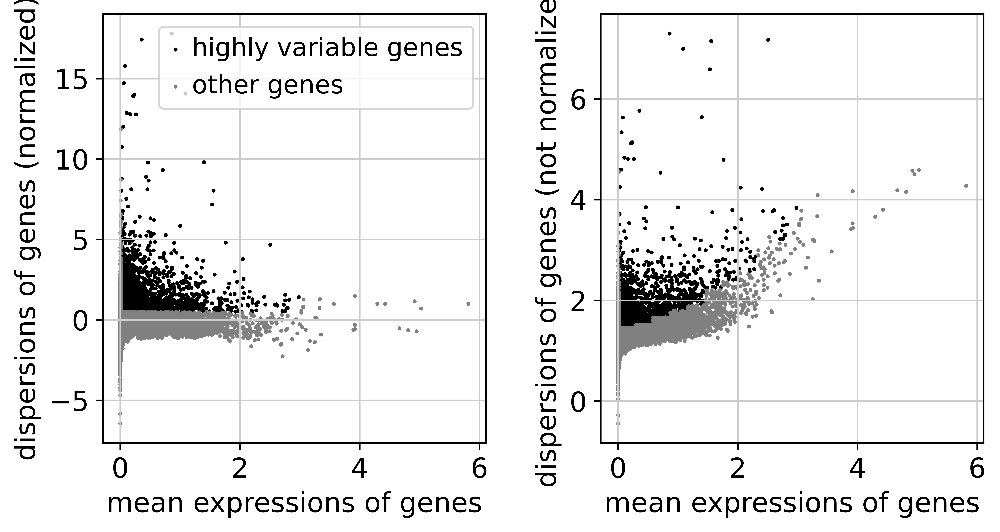

In [41]:
sc.pl.highly_variable_genes(adata)

In [42]:
adata.raw = adata

In [43]:
adata = adata[:, adata.var.highly_variable]

In [44]:
sc.pp.regress_out(adata, ["total_counts", "pct_counts_mt"])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:01:04)


In [45]:
sc.pp.scale(adata, max_value=10)

In [46]:
sc.tl.pca(adata, svd_solver="arpack")

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)


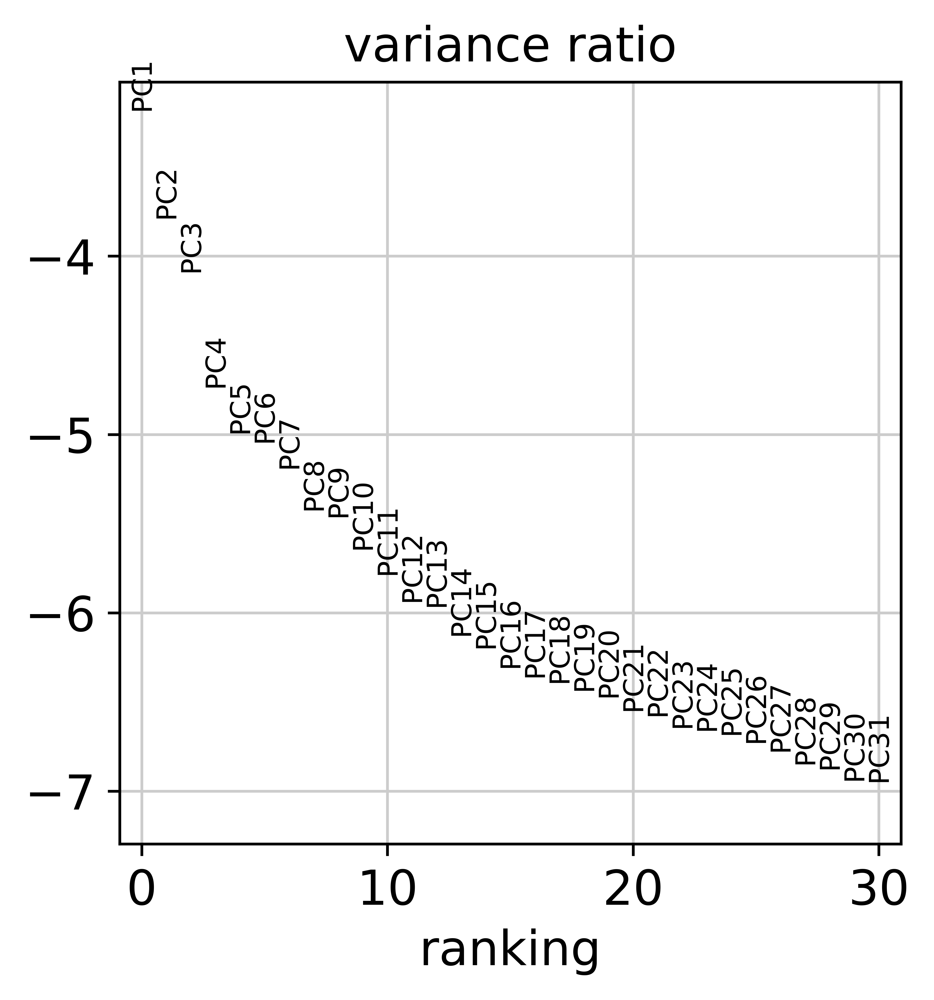

In [47]:
sc.pl.pca_variance_ratio(adata, log=True)

In [48]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:18)


In [49]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)


In [50]:
sc.tl.leiden(adata)

running Leiden clustering
    finished: found 35 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


/opt/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


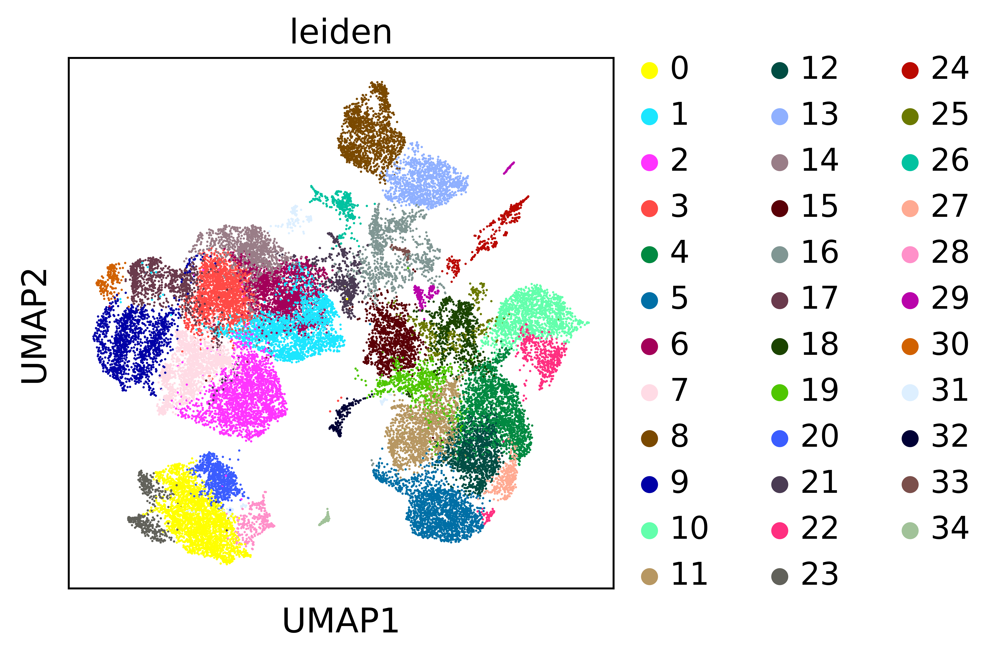

In [51]:
sc.pl.umap(adata, color=["leiden"])

In [52]:
sc.tl.tsne(adata, n_pcs=20)

computing tSNE
    using 'X_pca' with n_pcs = 20
    using sklearn.manifold.TSNE


/opt/venv/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:01:37)


/opt/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


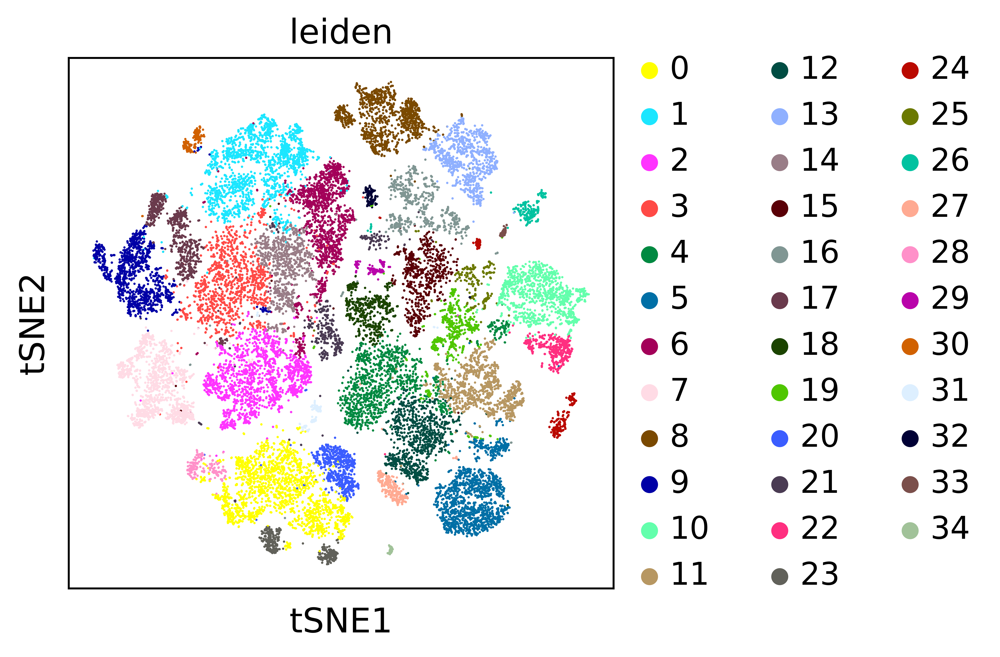

In [53]:
sc.pl.tsne(adata, color=["leiden"])

/opt/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


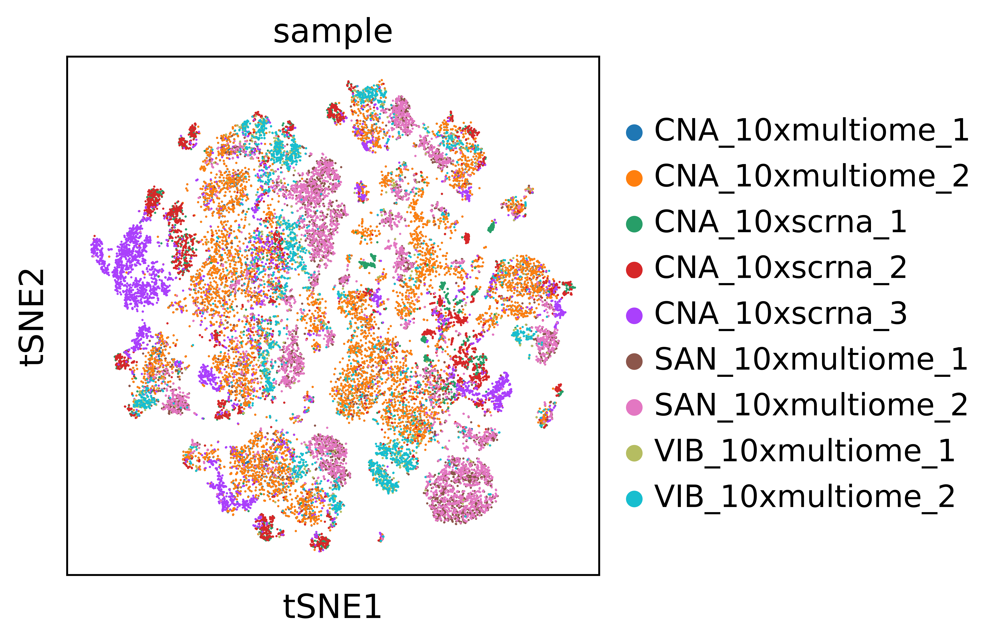

In [54]:
sc.pl.tsne(adata, color=["sample"])

In [55]:
adata.write("merged__adata.dimreduc.h5")

# try 10x matrices

In [2]:
dir_dict = {
    x.split("/")[0]: x
    for x in sorted(glob.glob("*10x*/outs/filtered_feature_bc_matrix/"))
}
dir_dict

{'CNA_10xmultiome_1': 'CNA_10xmultiome_1/outs/filtered_feature_bc_matrix/',
 'CNA_10xmultiome_2': 'CNA_10xmultiome_2/outs/filtered_feature_bc_matrix/',
 'CNA_10xscrna_1': 'CNA_10xscrna_1/outs/filtered_feature_bc_matrix/',
 'CNA_10xscrna_2': 'CNA_10xscrna_2/outs/filtered_feature_bc_matrix/',
 'CNA_10xscrna_3': 'CNA_10xscrna_3/outs/filtered_feature_bc_matrix/',
 'SAN_10xmultiome_1': 'SAN_10xmultiome_1/outs/filtered_feature_bc_matrix/',
 'SAN_10xmultiome_2': 'SAN_10xmultiome_2/outs/filtered_feature_bc_matrix/',
 'VIB_10xmultiome_1': 'VIB_10xmultiome_1/outs/filtered_feature_bc_matrix/',
 'VIB_10xmultiome_2': 'VIB_10xmultiome_2/outs/filtered_feature_bc_matrix/'}

In [3]:
total_count = 0
for sample, path in dir_dict.items():
    adata = sc.read_10x_mtx(path, cache=True)
    adata.obs["sample"] = sample
    adata.obs.index = [x + "-" + sample for x in adata.obs.index]
    if sample != "CNA_10xmultiome_1":
        adata_merged = adata_merged.concatenate(adata, index_unique=None)
    else:
        adata_merged = adata

    total_count += len(adata.obs)

print(total_count)

... reading from cache file cache/CNA_10xmultiome_1-outs-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/CNA_10xmultiome_2-outs-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/CNA_10xscrna_1-outs-filtered_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


... reading from cache file cache/CNA_10xscrna_2-outs-filtered_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


... reading from cache file cache/CNA_10xscrna_3-outs-filtered_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


... reading from cache file cache/SAN_10xmultiome_1-outs-filtered_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


... reading from cache file cache/SAN_10xmultiome_2-outs-filtered_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


... reading from cache file cache/VIB_10xmultiome_1-outs-filtered_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


... reading from cache file cache/VIB_10xmultiome_2-outs-filtered_feature_bc_matrix-matrix.h5ad


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


28099


/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [4]:
adata = adata_merged

In [5]:
adata.write("10xmerged__adata.raw.h5")

In [6]:
adata.var_names_make_unique()

normalizing counts per cell
    finished (0:00:00)


/opt/venv/lib/python3.8/site-packages/seaborn/categorical.py:470: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


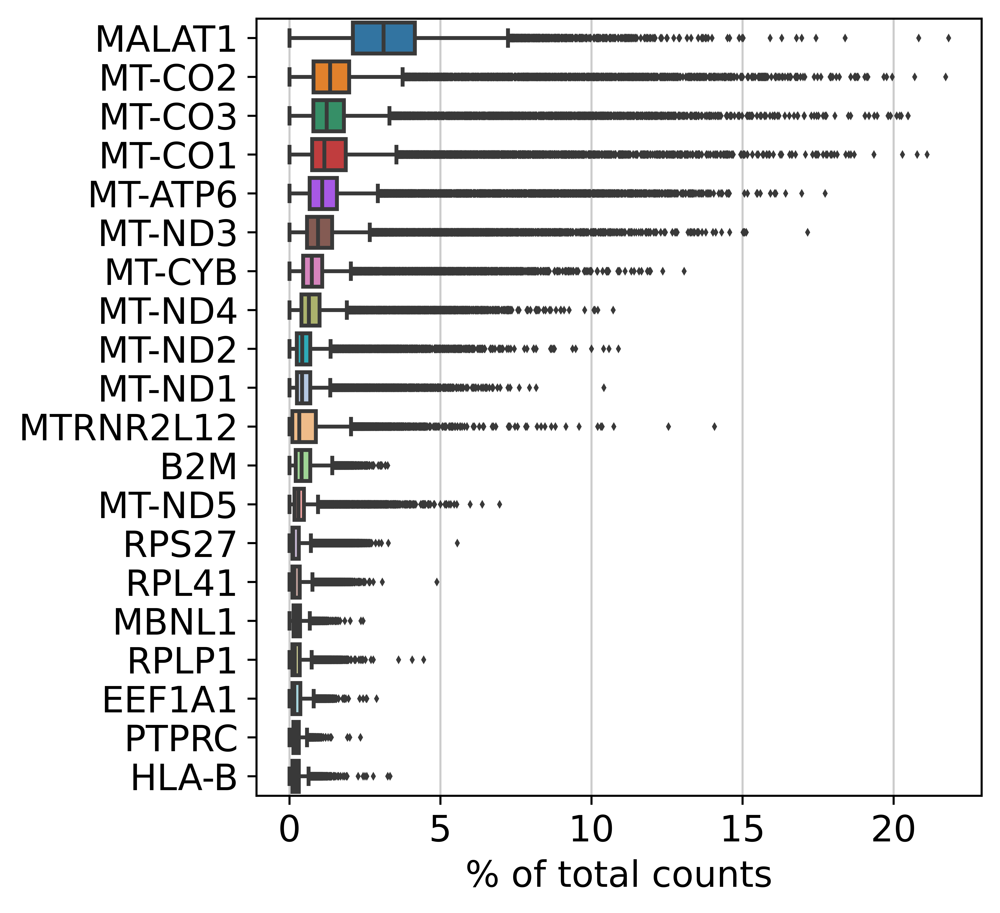

In [7]:
sc.pl.highest_expr_genes(
    adata,
    n_top=20,
)

In [8]:
adata_merged.obs

,sample,batch
AAACAGCCAGCATGTC-1-CNA_10xmultiome_1,CNA_10xmultiome_1,0
AAACAGCCAGGAAGCC-1-CNA_10xmultiome_1,CNA_10xmultiome_1,0
AAACAGCCATTGTGTG-1-CNA_10xmultiome_1,CNA_10xmultiome_1,0
AAACCGAAGATGCCTG-1-CNA_10xmultiome_1,CNA_10xmultiome_1,0
AAACCGAAGGAACCAA-1-CNA_10xmultiome_1,CNA_10xmultiome_1,0
...,...,...
TTTGTCTAGGCAGGTG-1-VIB_10xmultiome_2,VIB_10xmultiome_2,1
TTTGTGAAGGCATTAC-1-VIB_10xmultiome_2,VIB_10xmultiome_2,1
TTTGTGGCAATAATCC-1-VIB_10xmultiome_2,VIB_10xmultiome_2,1
TTTGTGGCACCTAAGC-1-VIB_10xmultiome_2,VIB_10xmultiome_2,1


In [9]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 1008 cells that have less than 200 genes expressed
filtered out 6876 genes that are detected in less than 3 cells


In [10]:
adata.var["mt"] = adata.var_names.str.startswith(
    "MT-"
)  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

In [11]:
sc.pl.violin(
    adata,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

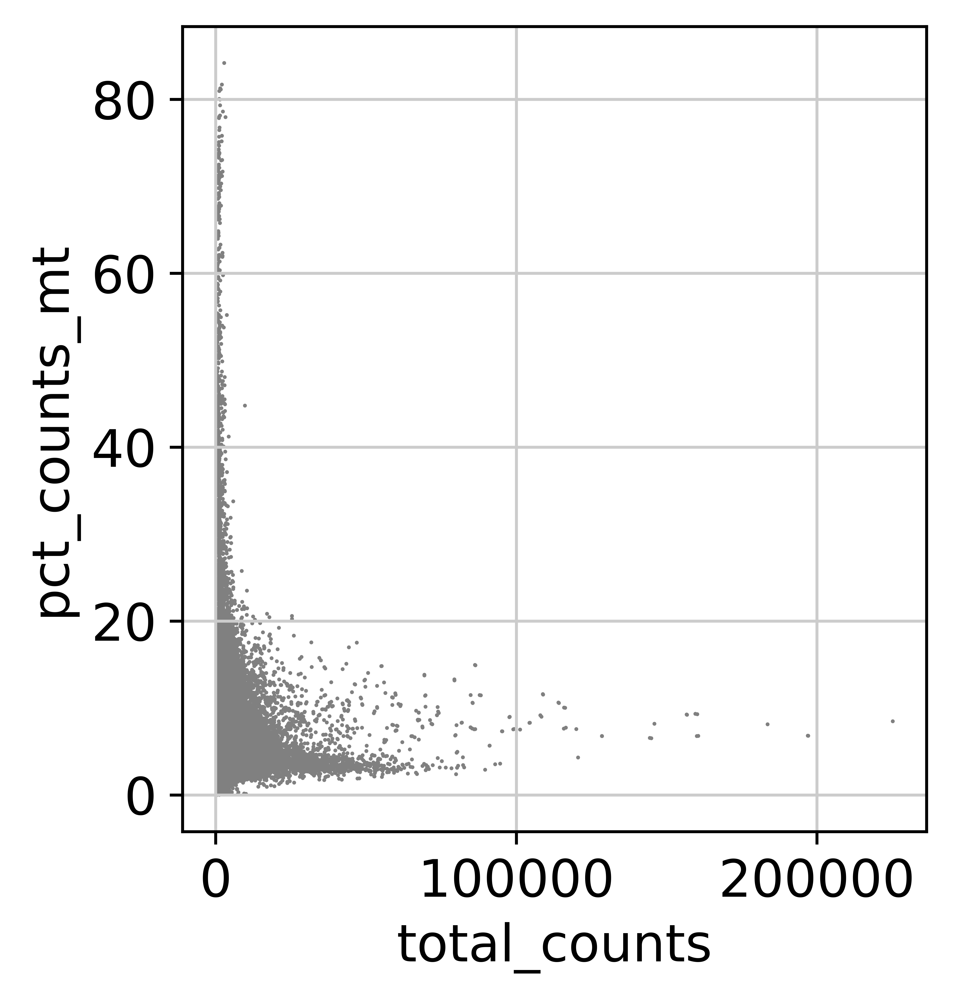

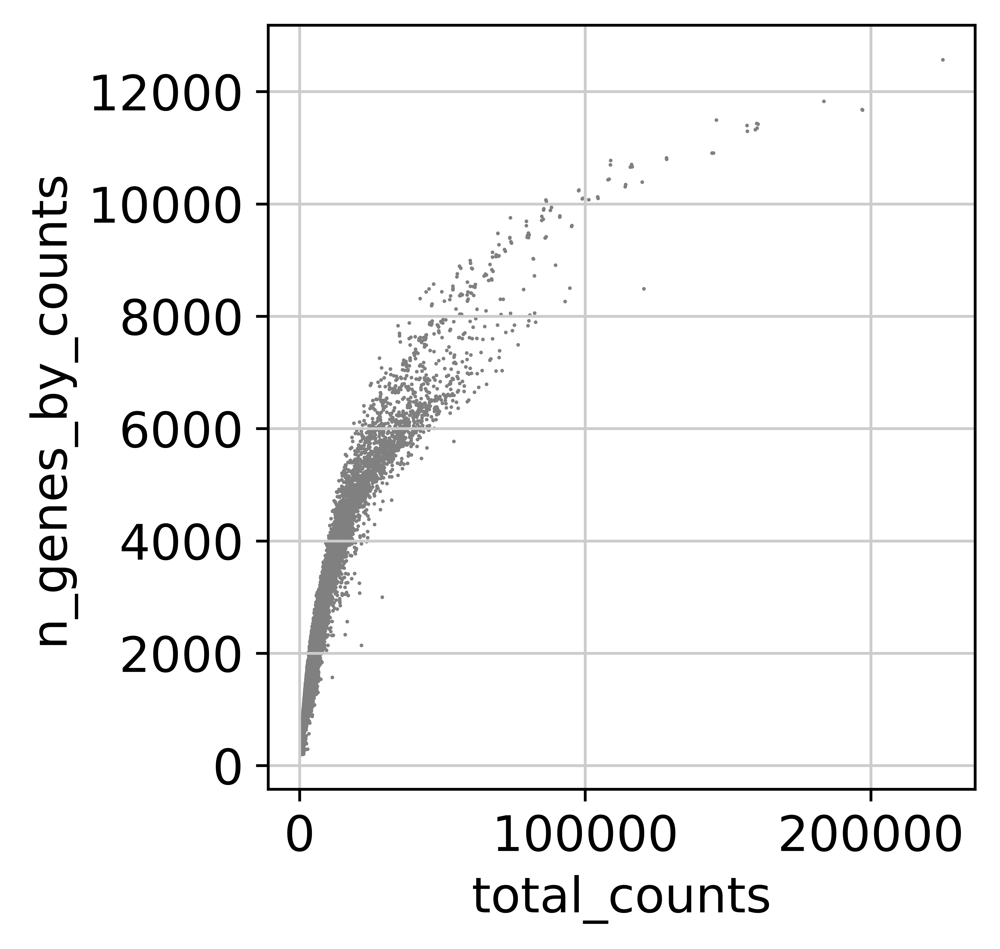

In [12]:
sc.pl.scatter(adata, x="total_counts", y="pct_counts_mt")
sc.pl.scatter(adata, x="total_counts", y="n_genes_by_counts")

In [13]:
adata = adata[adata.obs.n_genes_by_counts < 2500, :]
adata = adata[adata.obs.pct_counts_mt < 5, :]

In [14]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


/opt/venv/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [15]:
sc.pp.log1p(adata)

In [16]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


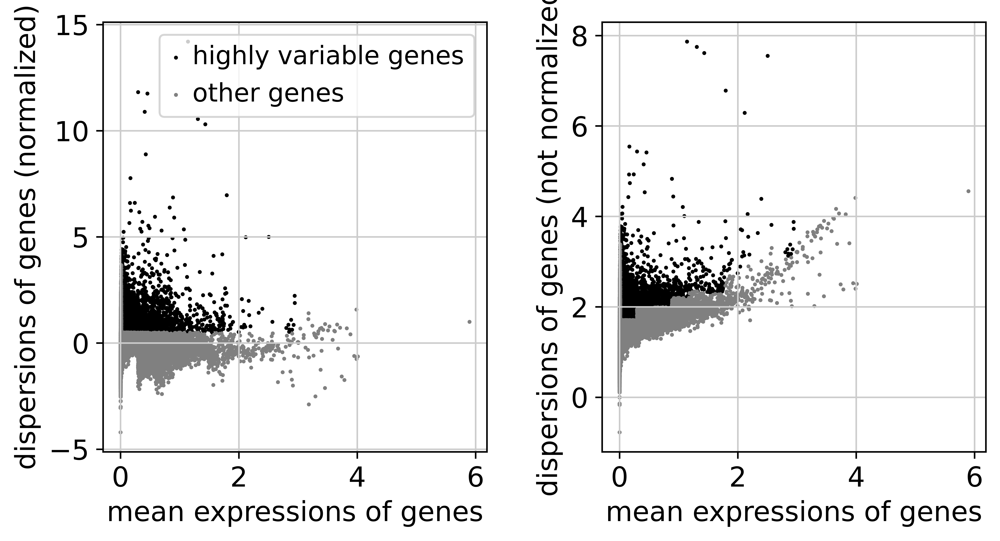

In [17]:
sc.pl.highly_variable_genes(adata)

In [18]:
adata.raw = adata

In [19]:
adata = adata[:, adata.var.highly_variable]

In [20]:
sc.pp.regress_out(adata, ["total_counts", "pct_counts_mt"])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:00:13)


In [21]:
sc.pp.scale(adata, max_value=10)

In [22]:
sc.tl.pca(adata, svd_solver="arpack")

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


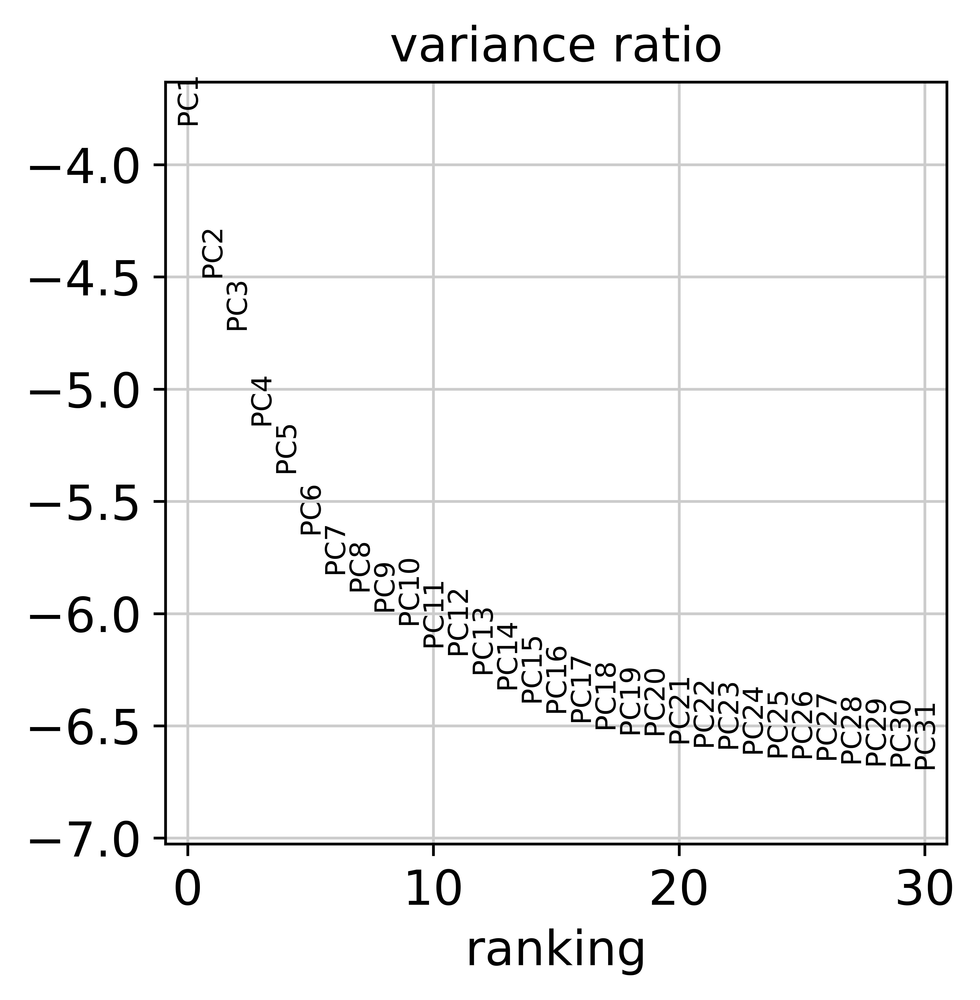

In [23]:
sc.pl.pca_variance_ratio(adata, log=True)

In [24]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


In [25]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [26]:
sc.tl.leiden(adata)

running Leiden clustering
    finished: found 26 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/opt/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


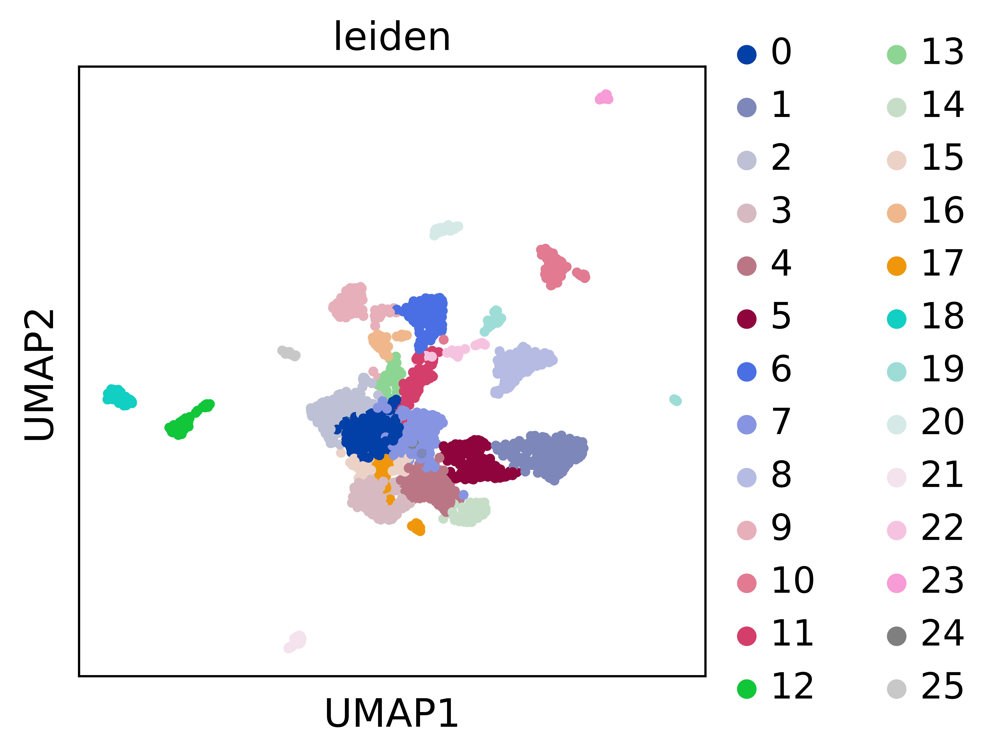

In [27]:
sc.pl.umap(adata, color=["leiden"])

In [28]:
sc.tl.tsne(adata, n_pcs=20)

computing tSNE
    using 'X_pca' with n_pcs = 20
    using sklearn.manifold.TSNE


/opt/venv/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:04)


/opt/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


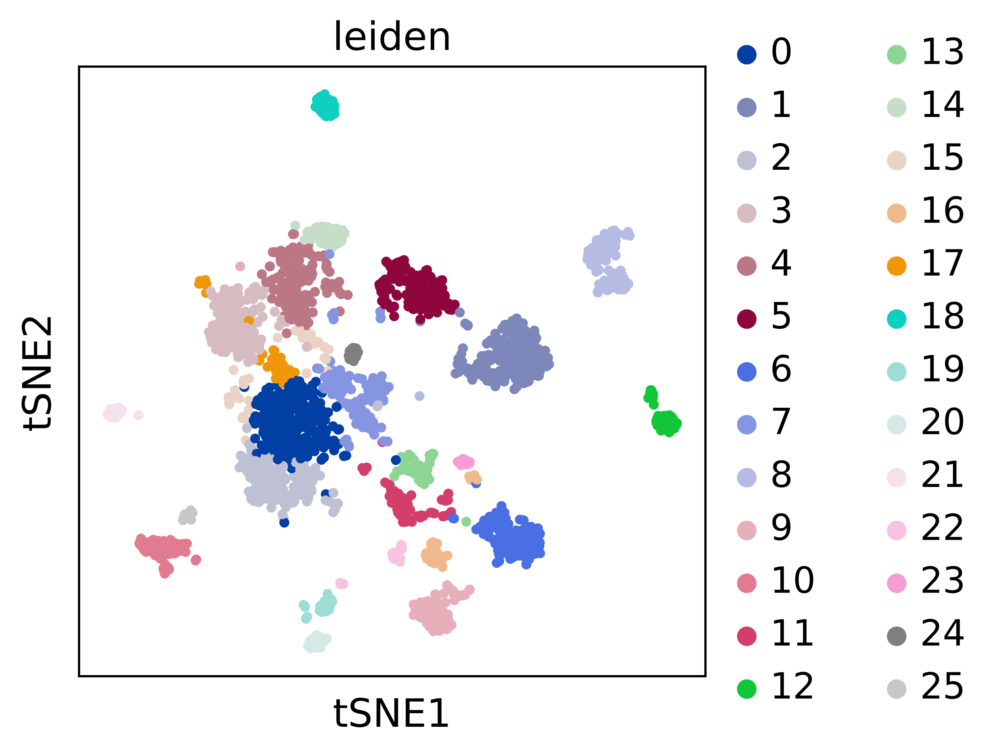

In [29]:
sc.pl.tsne(adata, color=["leiden"])

/opt/venv/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


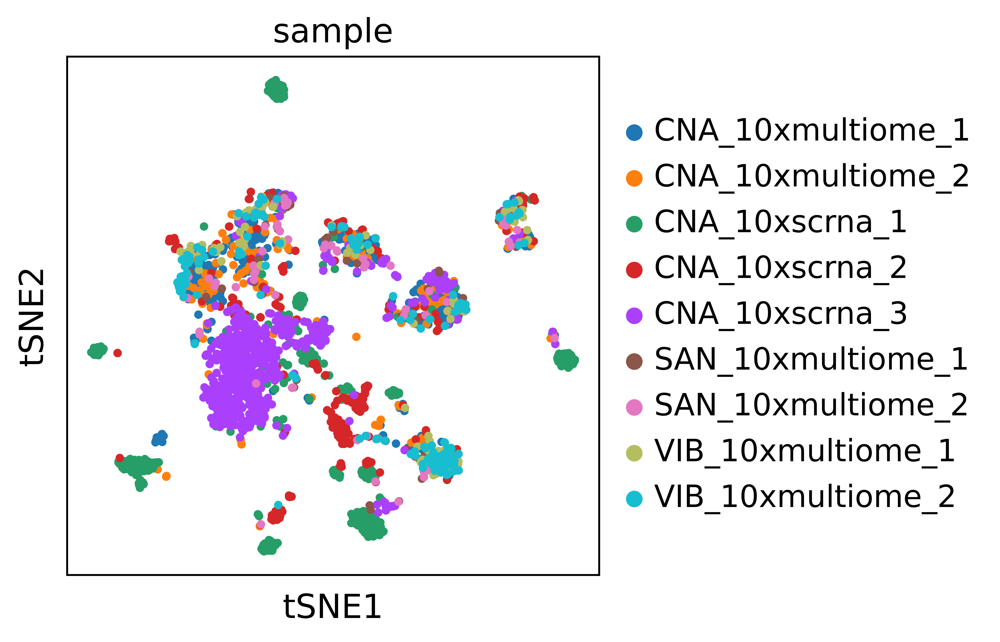

In [30]:
sc.pl.tsne(adata, color=["sample"])

In [31]:
adata.write("10xmerged__adata.dimreduc.h5")

# filter and then merge

# dir_dict = {
    x.split("/")[0]: x for x in sorted(glob.glob("*10x*/outs/raw_feature_bc_matrix/"))
}
dir_dict

In [40]:
for sample, directory in dir_dict.items():
    print(sample)

    adata = sc.read_10x_mtx(
        dir_dict[sample],  # the directory with the `.mtx` file
        var_names="gene_symbols",  # use gene symbols for the variable names (variables-axis index)
        cache=True,
    )

    # adata.var_names_make_unique()
    adata.var["mt"] = adata.var_names.str.startswith(
        "MT-"
    )  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(
        adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
    )

    sc.pp.filter_cells(adata, min_genes=5)
    adata.obs = adata.obs.sort_values("total_counts", ascending=False)
    sc.pp.filter_genes(adata, min_cells=3)
    adata.obs["rank"] = range(len(adata.obs))
    adata.obs["rank"] = adata.obs["rank"] + 1

    arr = np.log10(adata.obs["total_counts"])
    threshold_log = threshold_otsu(arr, nbins=5000, min_value=np.log10(min_x_val))
    threshold = int(10**threshold_log)

    threshold_rank = adata.obs[adata.obs["total_counts"] >= threshold]["rank"].max()

    fig, ax = plt.subplots(figsize=(10, 5))
    sns.scatterplot(data=adata.obs, x="rank", y="total_counts", linewidth=0, ax=ax)
    ax.hlines(y=threshold, xmin=1, xmax=1000000)
    ax.vlines(x=threshold_rank, ymin=1, ymax=1000000)
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlim([1, 1000000])
    plt.title(f"{sample} {threshold_rank} cells, minimum {threshold} counts")

    # plt.savefig(f"plots/{sample}_kneeplot.svg", dpi=300, facecolor="white")
    # plt.savefig(f"plots/{sample}_kneeplot.png", dpi=300, facecolor="white")

    plt.show()

    adata = adata[adata.obs["total_counts"] >= threshold]

    adata.obs["sample"] = sample
    adata.obs.index = [x + "-" + sample for x in adata.obs.index]
    if sample != "CNA_10xmultiome_1":
        adata_merged = adata_merged.concatenate(adata, index_unique=None)
    else:
        adata_merged = adata

    total_count += len(adata.obs)

adata.write("rna_qc/filteredandmerged__adata.raw.h5")

CNA_10xmultiome_1
... reading from cache file cache/CNA_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 455816 cells that have less than 5 genes expressed
filtered out 11007 genes that are detected in less than 3 cells


CNA_10xmultiome_2
... reading from cache file cache/CNA_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample


filtered out 457627 cells that have less than 5 genes expressed
filtered out 11040 genes that are detected in less than 3 cells


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


CNA_10xscrna_1
... reading from cache file cache/CNA_10xscrna_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 1047119 cells that have less than 5 genes expressed
filtered out 11771 genes that are detected in less than 3 cells


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


CNA_10xscrna_2
... reading from cache file cache/CNA_10xscrna_2-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 1142950 cells that have less than 5 genes expressed
filtered out 11017 genes that are detected in less than 3 cells


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


CNA_10xscrna_3
... reading from cache file cache/CNA_10xscrna_3-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 965254 cells that have less than 5 genes expressed
filtered out 12337 genes that are detected in less than 3 cells


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


SAN_10xmultiome_1
... reading from cache file cache/SAN_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 614983 cells that have less than 5 genes expressed
filtered out 12444 genes that are detected in less than 3 cells


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


SAN_10xmultiome_2
... reading from cache file cache/SAN_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 599293 cells that have less than 5 genes expressed
filtered out 12149 genes that are detected in less than 3 cells


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


VIB_10xmultiome_1
... reading from cache file cache/VIB_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 567173 cells that have less than 5 genes expressed
filtered out 14795 genes that are detected in less than 3 cells


VIB_10xmultiome_2
... reading from cache file cache/VIB_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


filtered out 571753 cells that have less than 5 genes expressed
filtered out 13727 genes that are detected in less than 3 cells


/tmp/ipykernel_2402684/3287299420.py:46: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["sample"] = sample
/opt/venv/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
